Copyright (c) 2019 OERCompBiomed (UiB)

## 0.0-test.ipynb

### (Seili-2019)

Adapted from https://github.com/alu042/DAT158ML and https://github.com/arvidl/lvv-ri

### python, numpy, pandas, matplotlib, scikit-learn, nibabel, biopython, tensorflow, ...

**If you successfully run through this notebook your Python environment is likely configured correctly** 

# How to use the Jupyter Notebook?

[Jupyter Notebook](http://jupyter.org/) is a useful tool for experimenting with code. Everything of code and text is written in HTML, Markdown og Python.

Use arrow keys to navigate between cells. Hit ENTER on a cell to swith to editing mode. ESC to get back. (Try now!)

In [1]:
print("This is a Jupyter cell containing Python code. Hit 'Run' in the menu to execute the cell.")

This is a Jupyter cell containing Python code. Hit 'Run' in the menu to execute the cell.


You can also run cells by typing **Shift+Enter** or **Ctrl+Enter**. Try running the cell above by using both of these.

You will find more information via the Help menu above.

`Seili-2019` will use Jupyter for most of the coding, and you will acquire good Notebook skills through practise. Here is a good tutorial on Jupyter Notebook that is recommended: [Jupyter Notebook Tutorial: The Definitive Guide](https://www.datacamp.com/community/tutorials/tutorial-jupyter-notebook).

# Import libraries

These are libraries that will be frequently used in the course:

In [2]:
# To display plots directly in the notebook:
%matplotlib inline

In [3]:
# A frequently used plotting libraryp:
import matplotlib
import matplotlib.pyplot as plt
print(matplotlib.__version__)

3.1.0


In [4]:
# An extension of matplotlib making it easy to generate even nicer plots:
import seaborn as sns
print(sns.__version__)

0.9.0


In [5]:
# A numerical libray for efficient manipulation of matrices (and more):
import numpy as np
print(np.__version__)

1.16.4


In [6]:
# To read, write and proecess tabular data:
import pandas as pd
print(pd.__version__)

0.25.0


In [7]:
# For machine learning:
import sklearn
print(sklearn.__version__)

0.21.2


In [8]:
# For machine learning:
#import pandas_ml # OBS! pandas_ml seems not to be compatible with pandas 0.25.0

In [9]:
# For medical image processing (neuro-imaging):
import nibabel
print(nibabel.__version__)

2.4.1


In [10]:
# Machine learning for neuro-imaging:
import nilearn
print(nilearn.__version__)

/Users/arvid/anaconda3/envs/Seili/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


0.5.2


In [11]:
# A simplified interface to the Insight Toolkit (ITK) for image, filtering, registration and segmentation
import SimpleITK as sitk
print(sitk.Version())

SimpleITK Version: 1.2.0 (ITK 4.13)
Compiled: Jan  3 2019 21:33:26



In [12]:
# To read and write images:
import imageio
print(imageio.__version__)

2.5.0


In [13]:
# Supress some warnings:
import warnings
warnings.filterwarnings('ignore')

In [14]:
# For image processing:
import skimage
print(skimage.__version__)

0.15.0


In [15]:
# For computational molecular biology:
import Bio
print(Bio.__version__)

1.74


In [16]:
# For interactive user interface:
import ipywidgets as widgets
print(widgets.__version__)

7.5.0


In [17]:
# For deep learning:
import tensorflow as tf
print(tf.__version__)

2.0.0-beta1


# Test libraries

**REMARK:**  The aim of the following is to test your installation. Do not despair if you do not see the meaning of each cell at this stage. You will get to know and understand this code during the course.

## `Numpy`

In [18]:
import numpy as np

In [19]:
a = np.array([1, 2, 3])
print(type(a))

<class 'numpy.ndarray'>


In [20]:
e = np.random.random((3,3))
e

array([[0.94216636, 0.3435813 , 0.07383043],
       [0.76142743, 0.04156948, 0.00971246],
       [0.22915833, 0.43356846, 0.62821164]])

## `matplotlib`: a simple plot

In [21]:
%matplotlib inline
import matplotlib.pyplot as plt

The following will give a figure displaying a sine function:

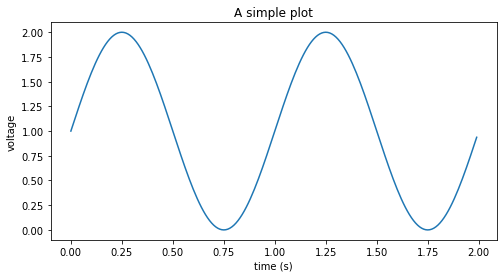

In [22]:
# Data to be plotted (generated by Numpy)
t = np.arange(0.0, 2.0, 0.01)
s = 1 + np.sin(2 * np.pi * t)

# Make a figure of given size
f, ax = plt.subplots(figsize=(8,4))

# Plot t versus s
plt.plot(t, s)

# Add a title and labels:
plt.title('A simple plot')
plt.xlabel('time (s)')
plt.ylabel('voltage')

# Show plot:
plt.show()

## `ipywidgets`: interactive user interface
Now we check that the ipywidgets will display correctly. When you run the following cell you should see a slider.<br>

In [23]:
from ipywidgets import interact, interactive
import ipywidgets as widgets

# Define function f that returns its argument
def f(x):
    return x

In [24]:
# Return the argument of f with an interactive slideing choice, and with a default value if no selection is made
w = interact(f, x=(0,10), value=5);

interactive(children=(IntSlider(value=5, description='x', max=10), Output()), _dom_classes=('widget-interact',…

In [25]:
print('x =', w.widget.result)

x = 5


In [26]:
# A dropdown menu (choose between different classifiers)
w = interact(f, x=['KNN','SVN', 'RF', 'LG']);

interactive(children=(Dropdown(description='x', options=('KNN', 'SVN', 'RF', 'LG'), value='KNN'), Output()), _…

In [27]:
print('x =', w.widget.result)

x = KNN


In [28]:
w = widgets.RadioButtons(
    options=['KNN', 'SVM', 'RF', 'LG'],
    value='RF',
    description='Classifier:',
    disabled=False
);

In [29]:
w

RadioButtons(description='Classifier:', index=2, options=('KNN', 'SVM', 'RF', 'LG'), value='RF')

In [30]:
print('x =', w.get_interact_value())

x = RF


In [31]:
accordion = widgets.Accordion(children=[widgets.IntSlider(), widgets.Text()])
accordion.set_title(0, 'Slider')
accordion.set_title(1, 'Text')
accordion

Accordion(children=(IntSlider(value=0), Text(value='')), _titles={'0': 'Slider', '1': 'Text'})

In [32]:
print('s =', accordion.children[0].get_interact_value())
print('t =', accordion.children[1].get_interact_value())

s = 0
t = 


In [33]:
def f(m, b):
    plt.figure(2)
    x = np.linspace(-10, 10, num=1000)
    plt.plot(x, m * x + b)
    plt.ylim(-5, 5)
    plt.grid()
    plt.show()

interactive_plot = interactive(f, m=(-2.0, 2.0), b=(-3, 3, 0.5))
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatSlider(value=0.0, description='m', max=2.0, min=-2.0), FloatSlider(value=0.0, descr…

## `Seaborn`: a more advanced plot

In [34]:
import seaborn as sns

Source: [Link](https://seaborn.pydata.org/examples/scatterplot_categorical.html)

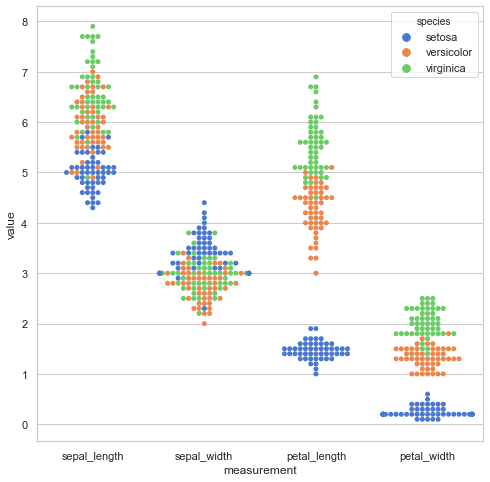

In [35]:
sns.set(style="whitegrid", palette="muted")

# Load the iris dataset
iris = sns.load_dataset("iris")

# "Melt" dataset to "long-form" or "tidy" representation
iris = pd.melt(iris, "species", var_name="measurement")

# Make a figure with given size
f, ax = plt.subplots(figsize=(8,8))

# Draw a categorical scatterplot to show each observation
sns.swarmplot(x="measurement", y="value", hue="species", data=iris, size=5, ax=ax)

plt.show()

## `Pandas`

In [36]:
import pandas as pd

In [37]:
df = pd.read_csv('../testdata/0.0-test_data.csv')

In [38]:
df.head()

,pregnancies,glucose,diastolic,triceps,insulin,bmi,dpf,age,diabetes
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


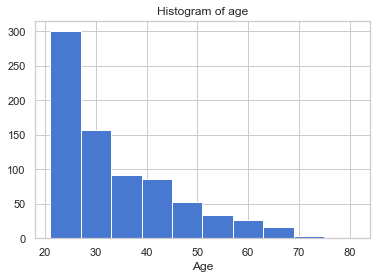

In [39]:
df['age'].hist()
plt.title("Histogram of age")
plt.xlabel("Age")
plt.show()

## `pandas_ml`: [Confusion matrix](https://en.wikipedia.org/wiki/Confusion_matrix) (CM)

In [40]:
#from pandas_ml import ConfusionMatrix  
# (pandas_ml seems not to be compatible with pandas 0.25.0)
# (using functions from. sklearn ing instead)

Reaction time (response inhibition) data from https://github.com/arvidl/lvv-ri :

In [41]:
y_true = ['slow', 'slow', 'slow', 'fast', 'slow', 'slow', 'fast', 'medium',
       'fast', 'medium', 'slow', 'medium', 'fast', 'medium', 'medium',
       'medium', 'medium', 'slow', 'medium', 'medium', 'fast', 'fast',
       'fast', 'fast', 'medium', 'slow', 'slow', 'fast', 'medium',
       'medium', 'slow', 'slow', 'slow', 'slow', 'fast', 'fast', 'fast',
       'medium', 'medium', 'medium', 'fast', 'fast', 'medium', 'medium',
       'medium', 'medium', 'fast', 'slow', 'slow', 'slow', 'slow', 'slow',
       'medium', 'fast', 'slow', 'slow', 'fast', 'slow', 'medium', 'fast',
       'slow', 'medium', 'slow', 'slow', 'medium', 'fast', 'fast', 'fast',
       'fast', 'fast', 'fast', 'fast', 'medium', 'slow']

In [42]:
y_pred = ['fast', 'medium', 'slow', 'medium', 'medium', 'slow', 'medium',
       'fast', 'slow', 'medium', 'fast', 'fast', 'slow', 'medium',
       'medium', 'medium', 'fast', 'fast', 'slow', 'fast', 'fast', 'fast',
       'fast', 'slow', 'slow', 'slow', 'slow', 'slow', 'medium', 'fast',
       'fast', 'fast', 'medium', 'fast', 'medium', 'medium', 'medium',
       'slow', 'slow', 'medium', 'fast', 'fast', 'medium', 'medium',
       'medium', 'fast', 'slow', 'medium', 'slow', 'slow', 'medium',
       'fast', 'fast', 'fast', 'fast', 'slow', 'slow', 'fast', 'slow',
       'fast', 'slow', 'medium', 'slow', 'slow', 'slow', 'fast', 'fast',
       'fast', 'fast', 'fast', 'fast', 'fast', 'fast', 'fast']

In [43]:
list(zip(y_true, y_pred))

[('slow', 'fast'),
 ('slow', 'medium'),
 ('slow', 'slow'),
 ('fast', 'medium'),
 ('slow', 'medium'),
 ('slow', 'slow'),
 ('fast', 'medium'),
 ('medium', 'fast'),
 ('fast', 'slow'),
 ('medium', 'medium'),
 ('slow', 'fast'),
 ('medium', 'fast'),
 ('fast', 'slow'),
 ('medium', 'medium'),
 ('medium', 'medium'),
 ('medium', 'medium'),
 ('medium', 'fast'),
 ('slow', 'fast'),
 ('medium', 'slow'),
 ('medium', 'fast'),
 ('fast', 'fast'),
 ('fast', 'fast'),
 ('fast', 'fast'),
 ('fast', 'slow'),
 ('medium', 'slow'),
 ('slow', 'slow'),
 ('slow', 'slow'),
 ('fast', 'slow'),
 ('medium', 'medium'),
 ('medium', 'fast'),
 ('slow', 'fast'),
 ('slow', 'fast'),
 ('slow', 'medium'),
 ('slow', 'fast'),
 ('fast', 'medium'),
 ('fast', 'medium'),
 ('fast', 'medium'),
 ('medium', 'slow'),
 ('medium', 'slow'),
 ('medium', 'medium'),
 ('fast', 'fast'),
 ('fast', 'fast'),
 ('medium', 'medium'),
 ('medium', 'medium'),
 ('medium', 'medium'),
 ('medium', 'fast'),
 ('fast', 'slow'),
 ('slow', 'medium'),
 ('slow', 'slo

In [44]:
# y_confusion_matrix = ConfusionMatrix(y_true, y_pred)
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

y_confusion_matrix = confusion_matrix(y_true, y_pred)

class_names = ['fast', 'medium', 'slow']  # lexicographic order
print(class_names, '\n')
print("Confusion matrix:\n%s" % y_confusion_matrix)

['fast', 'medium', 'slow'] 

Confusion matrix:
[[14  5  6]
 [ 8 10  6]
 [10  5 10]]


In [45]:
# Print confusion matrix statistics
# y_confusion_matrix.print_stats()
print(classification_report(y_true, y_pred, target_names = class_names))

              precision    recall  f1-score   support

        fast       0.44      0.56      0.49        25
      medium       0.50      0.42      0.45        24
        slow       0.45      0.40      0.43        25

    accuracy                           0.46        74
   macro avg       0.46      0.46      0.46        74
weighted avg       0.46      0.46      0.46        74



In [46]:
# OBS! pandas_ml seems not to be compatible with pandas 0.25.0, using heatmap from seaborn instead for cm plotting
# y_confusion_matrix.plot()
# plt.show()

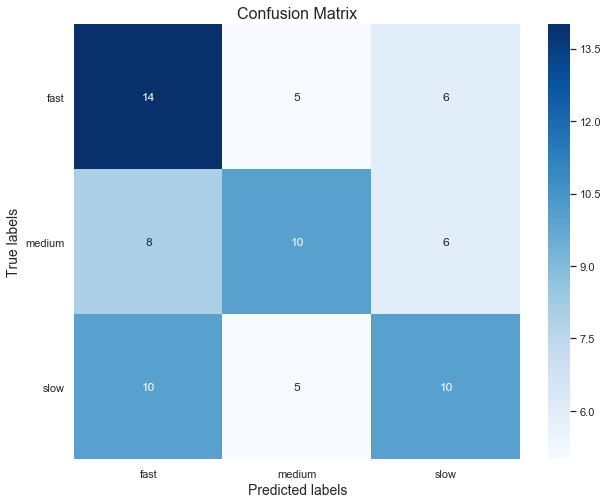

In [47]:
# Make a heatmap plot of the confusion matrix

fig, ax = plt.subplots(figsize=(10,8)) 
sns.heatmap(confusion_matrix(y_true, y_pred), 
            annot = True, # annot=True to annotate cells
            fmt = 'g',
            cmap = "Blues",
            ax = ax) 

# labels, title and ticks
ax.set_xlabel('Predicted labels', fontsize = 14)
ax.set_ylabel('True labels', fontsize = 14)
ax.set_title('Confusion Matrix', fontsize = 16) 
ax.xaxis.set_ticklabels(class_names)
ax.yaxis.set_ticklabels(class_names)
plt.yticks(rotation=0) 
plt.show()

In [48]:
# df_y_cm = y_confusion_matrix.to_dataframe() - pandas_ml seems not to be compatible with pandas 0.25.0
df_y_cm = pd.DataFrame(y_confusion_matrix)
df_y_cm

,0,1,2
0,14,5,6
1,8,10,6
2,10,5,10


In [49]:
# Rearrange the CM such that the labels are in the order 'slow', 'medium', 'fast'
x = df_y_cm.values.copy()
x[0][0] = df_y_cm.values[2][2]
x[0][2] = df_y_cm.values[2][0]
x[1][0] = df_y_cm.values[1][2]
x[1][2] = df_y_cm.values[1][0]
x[2][0] = df_y_cm.values[0][2]
x[2][2] = df_y_cm.values[0][0]
print(['slow', 'medium', 'fast'])
print(x)

['slow', 'medium', 'fast']
[[10  5 10]
 [ 6 10  8]
 [ 6  5 14]]


### `utils.py`

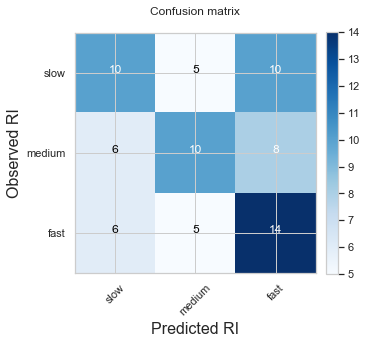

In [50]:
from utils import plot_confusion_matrix, plot_confusion_matrix_with_colorbar
cm = x
classes = ['slow', 'medium', 'fast'] 


plot_confusion_matrix_with_colorbar(cm, classes=classes, 
                                    title='Confusion matrix\n',
#                                    cmap='gray',
                                    figsize=(5,5))
plt.ylabel('Observed RI')
plt.xlabel('Predicted RI')
# fn_cm_pdf = '../figures/y_confusion_matrix.pdf'
#plt.savefig(fn_cm_pdf, transparent=True)

plt.show()

## `scikit-learn`: machine learning, e.g. [random forest](https://en.wikipedia.org/wiki/Random_forest) ensemble learning (RF)

In [51]:
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

In [52]:
# See https://scikit-learn.org/stable/datasets/index.html#breast-cancer-dataset for details
data = datasets.load_breast_cancer()

In [53]:
X = data['data']
y = data['target']
features = data['feature_names']
labels = data['target_names']

In [54]:
print(features)

['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']


In [55]:
print(labels)

['malignant' 'benign']


In [56]:
X_train, X_test, y_train, y_test = train_test_split(X, y)

In [57]:
rf = RandomForestClassifier(n_estimators=100)

In [58]:
rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [59]:
predictions = rf.predict(X_test)

In [60]:
accuracy_score(y_test, predictions) * 100

96.5034965034965

## `NiBabel` and `Nilearn`: Neuroimaging in Python

In [61]:
import nibabel as nib
import nilearn

In [62]:
img = nilearn.image.load_img('../testdata/0.0-test_nifti.nii.gz')

In [63]:
img.shape

(256, 256, 150)

In [64]:
from nibabel.viewers import OrthoSlicer3D

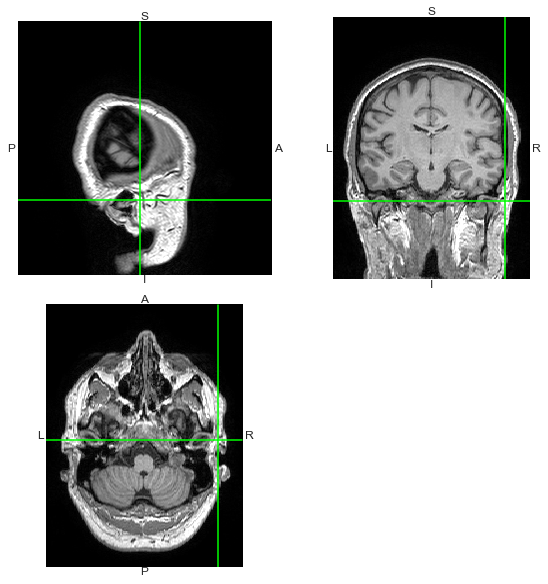

In [65]:
OrthoSlicer3D(img.get_data(), affine= img.affine).show()

In [66]:
# To ignore an unimportant warning generated by the below code 
# (remove the filter if you're curious)
import warnings 
warnings.simplefilter('ignore')

In [67]:
from nilearn import datasets, plotting
img = datasets.fetch_localizer_button_task()['tmap']
plotting.view_img_on_surf(img, threshold='90%', surf_mesh='fsaverage')

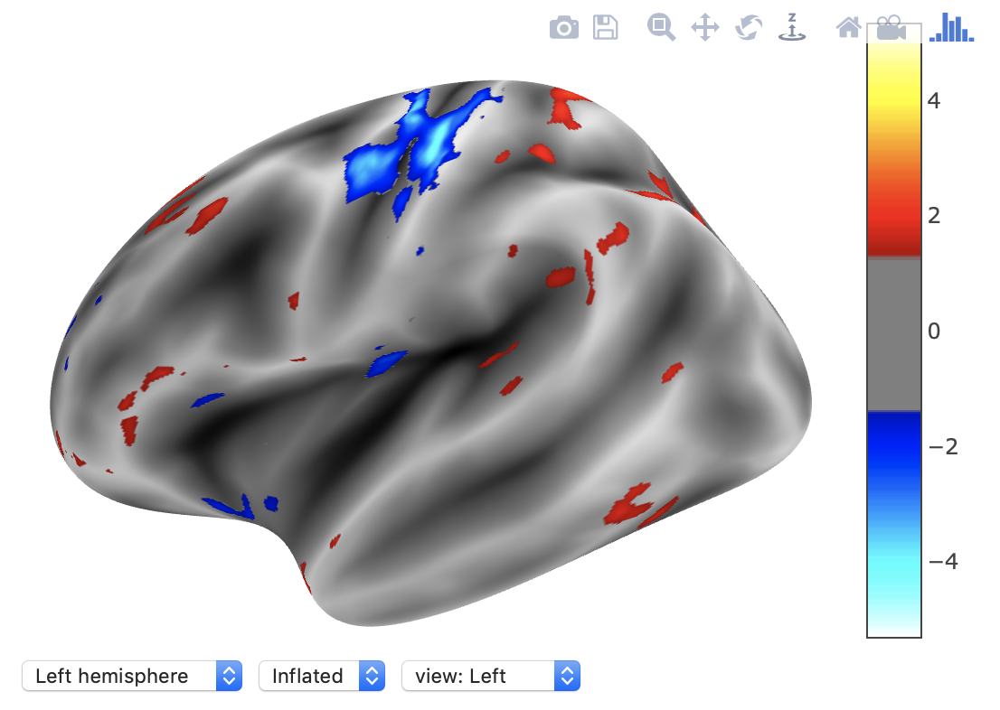

In [68]:
from IPython.display import Image
Image('./assets/test_view_img_on_surf.png', width=500)

## `SimpleITK`: Toolkit for image filtering, segmentation, and registration

In [69]:
# There are a variety of ways to create an image. All images' initial value is well defined as zero.
image = sitk.Image(256, 128, 64, sitk.sitkInt16)

# Get the n-dimensional numpy array of voxel values
nda = sitk.GetArrayFromImage(image)
print('Number of voxels:', image.GetNumberOfPixels())
print('Image matrix,min and max voxel values:', nda.shape, nda.min(), ',', nda.max())

Number of voxels: 2097152
Image matrix,min and max voxel values: (64, 128, 256) 0 , 0


Read **NIFTI image** using SimpleITK

In [70]:
image = sitk.ReadImage('../testdata/0.0-test_nifti.nii.gz')

In [71]:
# Accessing attributes

print(image.GetSize())
print(image.GetOrigin())
print(image.GetSpacing())
print(image.GetDirection())
print(image.GetNumberOfComponentsPerPixel())
print(image.GetWidth())
print(image.GetHeight())
print(image.GetDepth())
print(image.GetDimension())
print(image.GetPixelIDValue())
print(image.GetPixelIDTypeAsString())

(256, 256, 150)
(91.57415771484375, -146.60067749023438, -94.3832778930664)
(0.9374997615814209, 0.9374999403953552, 1.199998140335083)
(-0.022375056244124482, 0.01663138456396009, -0.9996113013681913, 0.9732082662020536, 0.229222039406966, -0.017970296266834083, -0.22883406095698527, 0.9732320656953289, 0.021314657610982935)
1
256
256
150
3
8
32-bit float


In [72]:
help(image.GetPixel)

Help on method GetPixel in module SimpleITK.SimpleITK:

GetPixel(*idx) method of SimpleITK.SimpleITK.Image instance
    Returns the value of a pixel.
    
    This method takes 2 parameters in 2D: the x and y index,
    and 3 parameters in 3D: the x, y and z index.



In [73]:
print('Original value:', image.GetPixel(128, 128, 64))
image.SetPixel(128,128, 64, 1)
print('New value:',image.GetPixel(128, 128, 64))

Original value: 1191.232421875
New value: 1.0


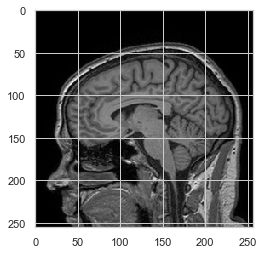

In [74]:
z = 70
slice = np.flipud(sitk.GetArrayViewFromImage(image)[z,:,:])   # Flip slice up-down for correct display
plt.imshow(slice, cmap="gray")
plt.show()

A two-dimensional [**Gabor filter**](https://en.wikipedia.org/wiki/Gabor_filter):

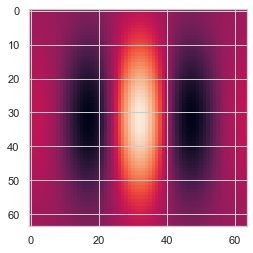

In [75]:
img = sitk.GaborSource(size=[64]*2, frequency=.03)
def myshow(img):
    nda = sitk.GetArrayViewFromImage(img)
    plt.imshow(nda)
myshow(img)

## `scikit-image`: Image processing in Python

One example from <a href="http://scikit-image.org/docs/stable/auto_examples/color_exposure/plot_ihc_color_separation.html">scikit-image</a>-documentation: **Immunohistochemical staining colors separation**

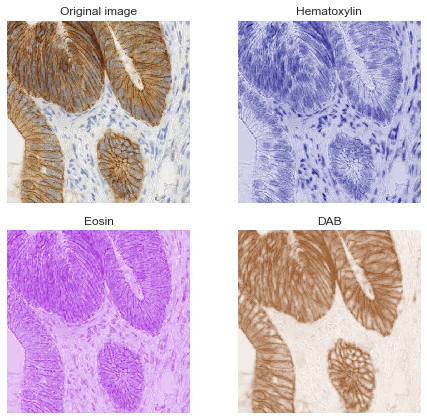

In [76]:
import matplotlib.pyplot as plt

from skimage import data
from skimage.color import rgb2hed
from matplotlib.colors import LinearSegmentedColormap

# Create an artificial color close to the original one
cmap_hema = LinearSegmentedColormap.from_list('mycmap', ['white', 'navy'])
cmap_dab = LinearSegmentedColormap.from_list('mycmap', ['white',
                                             'saddlebrown'])
cmap_eosin = LinearSegmentedColormap.from_list('mycmap', ['darkviolet',
                                               'white'])

ihc_rgb = data.immunohistochemistry()
ihc_hed = rgb2hed(ihc_rgb)

fig, axes = plt.subplots(2, 2, figsize=(7, 6))
ax = axes.ravel()

ax[0].imshow(ihc_rgb)
ax[0].set_title("Original image")

ax[1].imshow(ihc_hed[:, :, 0], cmap=cmap_hema)
ax[1].set_title("Hematoxylin")

ax[2].imshow(ihc_hed[:, :, 1], cmap=cmap_eosin)
ax[2].set_title("Eosin")

ax[3].imshow(ihc_hed[:, :, 2], cmap=cmap_dab)
ax[3].set_title("DAB")

for a in ax.ravel():
    a.axis('off')

fig.tight_layout()

Manipulation of hematoxylin and DAB-«channels»:

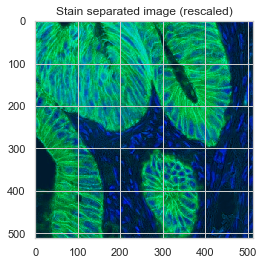

In [77]:
import numpy as np
from skimage.exposure import rescale_intensity

# Rescale hematoxylin and DAB signals and give them a fluorescence look
h = rescale_intensity(ihc_hed[:, :, 0], out_range=(0, 1))
d = rescale_intensity(ihc_hed[:, :, 2], out_range=(0, 1))
zdh = np.dstack((np.zeros_like(h), d, h))

fig, ax = plt.subplots()
ax.imshow(zdh)
ax.set_title("Stain separated image (rescaled)")
#ax.axis('off')
plt.show()

## `imageio` : Python library for reading and writing image data

Reading single-slice 4-channel MR images in DICOM format (we will use these data lagter in the course)

In [78]:
channels = ['FLASH', 'DESS', 'FISP', 'PSIF']
nb_channels = len(channels)

In [79]:
images = [imageio.imread(f'../testdata/{channel.lower()}_060.dcm') for channel in channels] 

In [80]:
nrow, ncol = images[0].shape

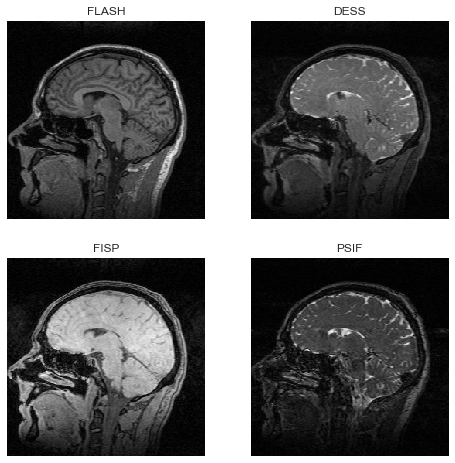

In [81]:
fig, axes = plt.subplots(2, 2, figsize=(8, 8))
ax = axes.ravel()

for i, im in enumerate(images):
    ax[i].imshow(im, cmap='gray')
    ax[i].set_title(channels[i])
    ax[i].axis('off')

plt.show()

(256, 256, 3)


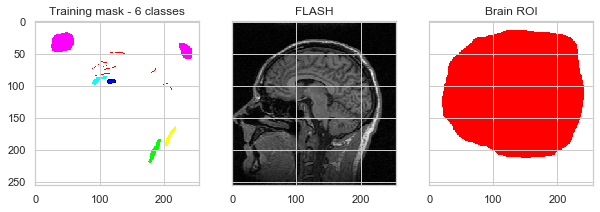

In [82]:
# Classes (color-coded): air, gm, wm, csf, fat, mus(cle)
train_mask = imageio.imread("../testdata/flash_060_training_mask_6cla.png")
roi_mask = imageio.imread("../testdata/flash_060_brain_mask.png")
print(train_mask.shape)

fig, axes = plt.subplots(1, 3, figsize=(10, 16), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(train_mask)
ax[0].set_title("Training mask - 6 classes")
ax[1].imshow(images[0], cmap='gray')
ax[1].set_title("FLASH")
ax[2].imshow(roi_mask)
ax[2].set_title("Brain ROI")
plt.show()

In [83]:
# Number of occurences of each unique color (class label in training mask) in descending order
from collections import Counter
Counter([tuple(colors) for i in train_mask for colors in i]).most_common()

[((255, 255, 255), 63519),
 ((255, 0, 255), 1250),
 ((0, 255, 0), 250),
 ((255, 255, 0), 170),
 ((255, 0, 0), 136),
 ((0, 255, 255), 129),
 ((0, 0, 255), 51),
 ((0, 0, 0), 31)]

In [84]:
# Count the number of occurences of oixels in ROI mask
Counter([tuple(colors) for i in roi_mask for colors in i]).most_common()

[((255, 0, 0), 35822), ((255, 255, 255), 29714)]

## Biopython

In [85]:
# Quick example from https://biopython.org/wiki/Getting_Started
from Bio.Seq import Seq

#create a sequence object
my_seq = Seq('CATGTAGACTAG')

#print out some details about it
print('seq %s is %i bases long' % (my_seq, len(my_seq)))
print('reverse complement is %s' % my_seq.reverse_complement())
print('protein translation is %s' % my_seq.translate())

seq CATGTAGACTAG is 12 bases long
reverse complement is CTAGTCTACATG
protein translation is HVD*


You should get the following output:
```python
seq CATGTAGACTAG is 12 bases long
reverse complement is CTAGTCTACATG
protein translation is HVD*
```

## Tensorflow

In [86]:
import tensorflow as tf
print('tf version:', tf.__version__, '\n')

# Matrix A and B with shapes (2, 3) and (3, 4)
mmv_matrix_A = tf.ones([2, 3], name="matrix_A")
mmv_matrix_B = tf.constant([[1, 2, 3, 4], [1, 2, 3, 4], [1, 2, 3, 4]], name="matrix_B", dtype=tf.float32)

# Matrix Multiplication: C = AB with C shape (2, 4)
matrix_multiply_C = tf.matmul(mmv_matrix_A, mmv_matrix_B, name="matrix_multiply_C")

print("""Matrix A: shape {0} \nelements: \n{1} \n\nMatrix B: shape {2} \nelements: \n{3}
\nMatrix C: shape {4} \nelements: \n{5}""".format(mmv_matrix_A.shape, mmv_matrix_A, mmv_matrix_B.shape, mmv_matrix_B, matrix_multiply_C.shape, matrix_multiply_C))

tf version: 2.0.0-beta1 

Matrix A: shape (2, 3) 
elements: 
[[1. 1. 1.]
 [1. 1. 1.]] 

Matrix B: shape (3, 4) 
elements: 
[[1. 2. 3. 4.]
 [1. 2. 3. 4.]
 [1. 2. 3. 4.]]

Matrix C: shape (2, 4) 
elements: 
[[ 3.  6.  9. 12.]
 [ 3.  6.  9. 12.]]
